## AirBNB NYC Data Analysis
Airbnb, Inc. is an American company that operates an online marketplace for lodging, primarily homestays for vacation rentals, and tourism activities. Airbnb does not own any of the listed properties; instead, it profits by receiving commission from each booking. 

This notebook is made to analyse data from New York City Airbnb Open Data in 2019.

Dataset was taken from https://www.kaggle.com/dgomonov/new-york-city-airbnb-open-data/tasks?taskId=181

![AirBNB Logo](https://rtvi.com/upload/iblock/636/6364ff2020cf0c871c7f604221253408.png)

 If you're not familiar with map of NYC, you can see it below


![NYC Boro](https://ontheworldmap.com/usa/city/new-york-city/nyc-boroughs-map.jpg)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
import warnings
warnings.filterwarnings('ignore')


In [2]:
data = pd.read_csv('AB_NYC_2019.csv')
data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [3]:
data.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [4]:
data.isna().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

Cleaning data

In [5]:
data = data[data.name.notna()]
data['host_name'].fillna('Unknown', inplace=True)
data['reviews_per_month'].fillna(0, inplace=True)


Transforming data

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48879 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48879 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48879 non-null  int64  
 3   host_name                       48879 non-null  object 
 4   neighbourhood_group             48879 non-null  object 
 5   neighbourhood                   48879 non-null  object 
 6   latitude                        48879 non-null  float64
 7   longitude                       48879 non-null  float64
 8   room_type                       48879 non-null  object 
 9   price                           48879 non-null  int64  
 10  minimum_nights                  48879 non-null  int64  
 11  number_of_reviews               48879 non-null  int64  
 12  last_review                     

In [7]:
data['last_review'] = pd.to_datetime(data['last_review'])

## EDA

In [8]:
sns.set_style('darkgrid')

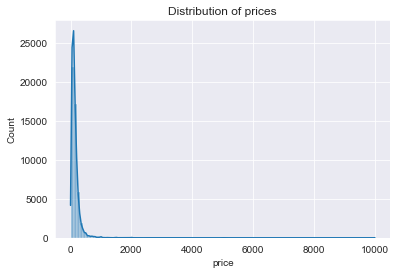

In [9]:
sns.histplot(data=data, x='price', bins=100, kde=True)
plt.title('Distribution of prices')
plt.show()


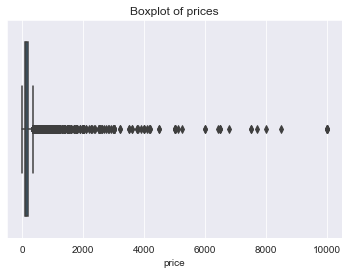

In [10]:
sns.boxplot(data=data, x='price')
plt.title('Boxplot of prices')
plt.show()


As we can see, distribution of prices is very skewed and there're a lot of outliers in price of listings.

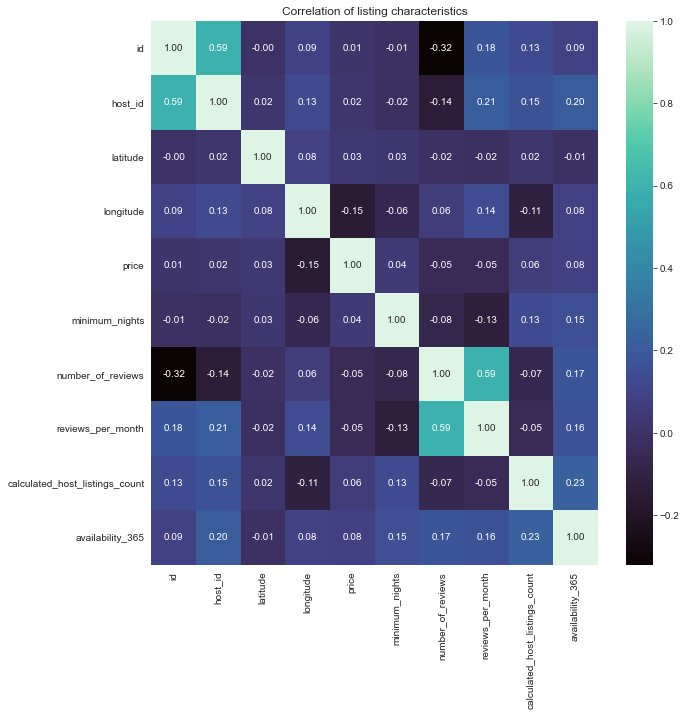

In [11]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(data.corr(), annot=True, fmt='.2f', cmap="mako")

plt.title("Correlation of listing characteristics")
plt.show()


From correlation matrix, significant correlation can be seen in:
    <li>id of listing and host id (probably explained by data scraping method)</li>
    <li>reviews per month and number of reviews (not surprising)</li>

## What can we learn about different areas?

First of all let's look at number of listings in each borough.

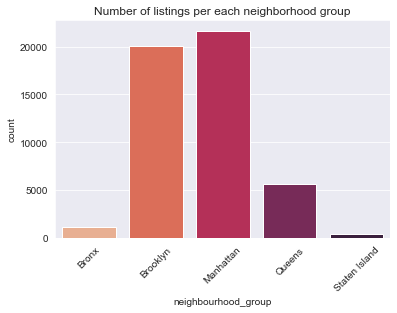

In [12]:
n_by_neighbourhood_group = data[[
    'id', 'neighbourhood_group']].groupby('neighbourhood_group').count()
n_by_neighbourhood_group.reset_index(inplace=True)
n_by_neighbourhood_group.columns = ['neighbourhood_group', 'count']

sns.barplot(x='neighbourhood_group', y='count', data=n_by_neighbourhood_group, palette="rocket_r")
plt.xticks(rotation=45)
plt.title('Number of listings per each neighborhood group')
plt.show()

Manhattan and Brooklyn has significantly more listings than other boroughs in NYC.

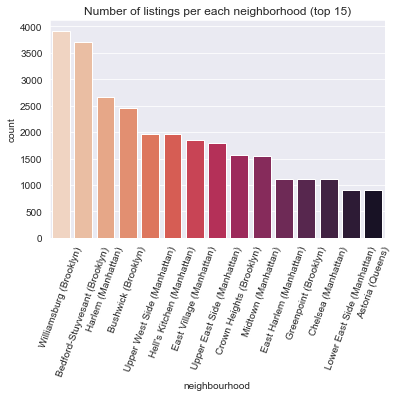

In [13]:
n_by_neighbourhood = data[['id', 'neighbourhood']]
n_by_neighbourhood['neighbourhood'] = data['neighbourhood'] + \
    " (" + data['neighbourhood_group'] + ")"

n_by_neighbourhood = n_by_neighbourhood.groupby('neighbourhood').count()
n_by_neighbourhood.reset_index(inplace=True)
n_by_neighbourhood.columns = ['neighbourhood', 'count']

sns.barplot(x='neighbourhood', y='count',
            data=n_by_neighbourhood.sort_values('count',ascending=False).head(15), palette="rocket_r")
plt.xticks(rotation=70)
plt.title('Number of listings per each neighborhood (top 15)')
plt.show()


As we see, top 15 neighbourhoods in NYC by listings count almost exclusively situdated in Brooklyn and Manhattan, with Astoria (Queens) in 15th place.

Let's look on price distribution by borough, taking in account prices that are lower than 500$, to get more clear insight into AirBNB prices in NYC.

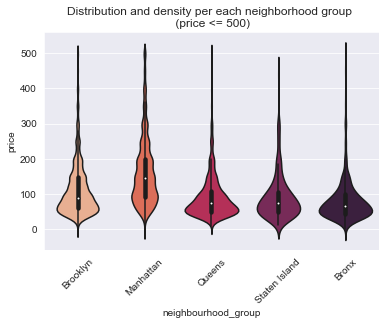

In [14]:
sns.violinplot(x='neighbourhood_group', y='price',
            data=data[data['price']<=500], palette="rocket_r")
plt.xticks(rotation=45)
plt.title('Distribution and density per each neighborhood group \n (price <= 500)')
plt.show()


As we can see there are a lot of choices of apartments in different price ranges in Manhattan. Most apartments in Brooklyn, Queens and Bronx are lower than 300$. What is surprising (or not) there are very small amount of apartments in Staten Island that cost higher than 500$.

## Analyze whether there is a difference in price by room type.

First of all, to analyze this, let's look at amount of listings by room type.

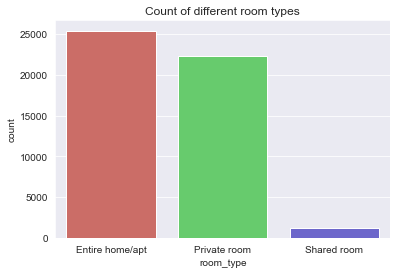

In [15]:
room_count = data[['room_type', 'id']].groupby('room_type').count()
room_count.reset_index(inplace=True)
room_count.columns = ['room_type', 'count']

sns.barplot(data=room_count, palette="hls", x='room_type', y='count')
plt.title('Count of different room types')
plt.show()


As we can see, most of listings are either entire apartments of private rooms, with small proportion of shared ones.

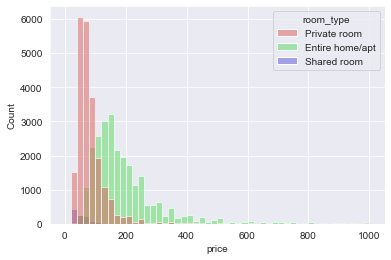

In [16]:
sns.histplot(x='price', bins=50, palette="hls", hue='room_type', data=data[data['price'] <= 1000])
plt.show()


As we can see, there is a clear difference in price of different room types, which is not unexpected. It could've been easily said that entire apartment costs more than private room,  not to mention shared.

## Spatial analysis

To understand data better, let's find some insights looking at map of NYC.

In [17]:
import geopandas as gpd
nyc = gpd.read_file(
    gpd.datasets.get_path("nybb")).to_crs(epsg=4326)

First of all, let's look on number of listings by borough, but this time on the map.

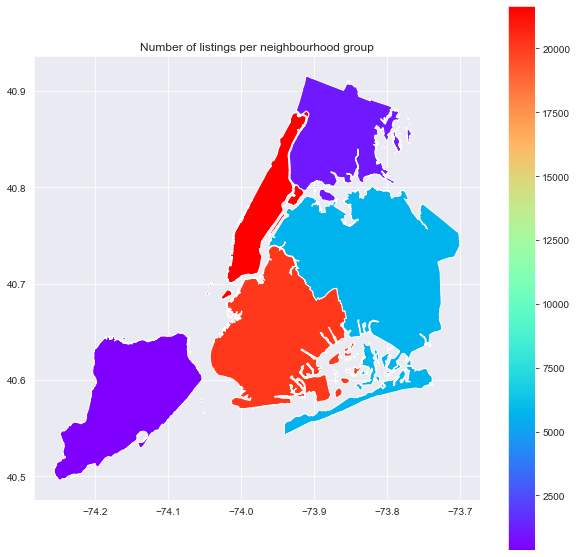

In [18]:
nyc_count = nyc.join(n_by_neighbourhood_group.rename(columns={'neighbourhood_group': 'BoroName'}).set_index('BoroName'), on='BoroName')
fig, ax = plt.subplots(figsize=(10,10))

nyc_count.plot(column='count',ax=ax,legend=True, cmap='rainbow')

plt.title('Number of listings per neighbourhood group')
plt.show()


Let's compare listings on the map, based on their availability

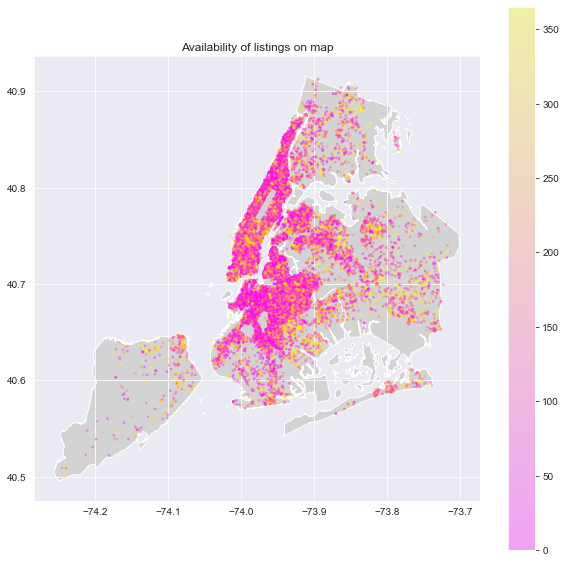

In [19]:
map_data_a = data[['latitude', 'longitude', 'availability_365']]

fig, ax = plt.subplots(figsize=(10, 10))
sc_a = ax.scatter(x='longitude', y='latitude',
                  data=map_data_a, alpha=0.3, s=3, zorder=1, c='availability_365', cmap='spring')

nyc.plot(color="lightgrey", ax=ax, zorder=0)

plt.title('Availability of listings on map')
plt.colorbar(sc_a)
plt.show()


As we see, apartments that opened 365 days a year is avaliable in each borough and it seems that there is no pattern here.

Next step is to compare prices of listings, based on their geolocation

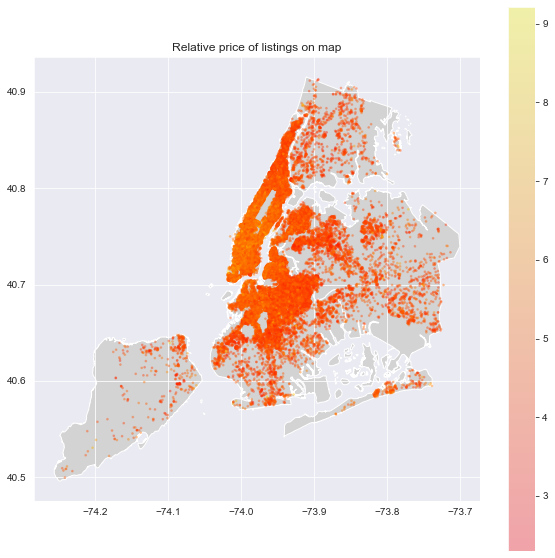

In [20]:
map_data_p = data[['latitude', 'longitude', 'price']]

#scale price
map_data_p['price'] = np.log(map_data_p['price'])

fig, ax = plt.subplots(figsize=(10, 10))
sc_p = ax.scatter(x='longitude', y='latitude',
                  data=map_data_p, alpha=0.3, s=3, zorder=1, c='price', cmap='autumn')

nyc.plot(color="lightgrey", ax=ax, zorder=0)

plt.title('Relative price of listings on map')
plt.colorbar(sc_p)
plt.show()


As we can see, the most expensive listings located in Manhattan and its surrounding areas.

In [21]:
price_by_boro = data[[
    'price', 'neighbourhood_group']].groupby('neighbourhood_group').mean()
price_by_boro.reset_index(inplace=True)
price_by_boro.columns = ['neighbourhood_group', 'mean_price']


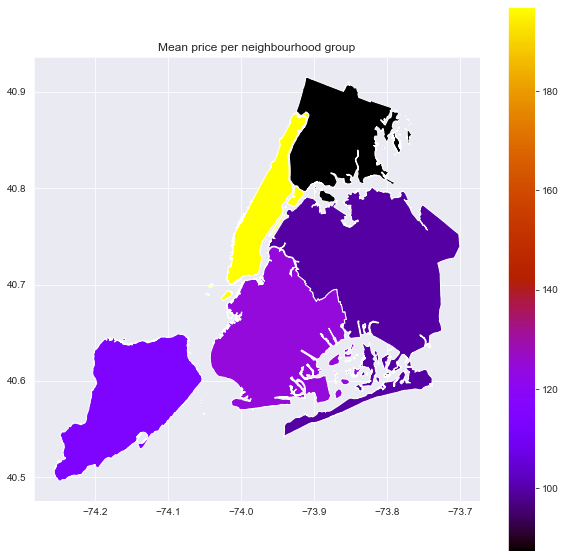

In [22]:
nyc_price = nyc.join(price_by_boro.rename(
    columns={'neighbourhood_group': 'BoroName'}).set_index('BoroName'), on='BoroName')

fig, ax = plt.subplots(figsize=(10, 10))

nyc_price.plot(column='mean_price', ax=ax, legend=True, cmap='gnuplot')

plt.title('Mean price per neighbourhood group')
plt.show()


Again, as we can see living in Manhattan costs much more than in any other borough. Living cost in other areas is roughly the same, except Bronx, where its noticebly cheaper.

## Basic NLP

In [23]:
data['name']

0                       Clean & quiet apt home by the park
1                                    Skylit Midtown Castle
2                      THE VILLAGE OF HARLEM....NEW YORK !
3                          Cozy Entire Floor of Brownstone
4         Entire Apt: Spacious Studio/Loft by central park
                               ...                        
48890      Charming one bedroom - newly renovated rowhouse
48891        Affordable room in Bushwick/East Williamsburg
48892              Sunny Studio at Historical Neighborhood
48893                 43rd St. Time Square-cozy single bed
48894    Trendy duplex in the very heart of Hell's Kitchen
Name: name, Length: 48879, dtype: object

## What can we learn about different hosts?

Let's explore different data about hosts and gather some insights about them.

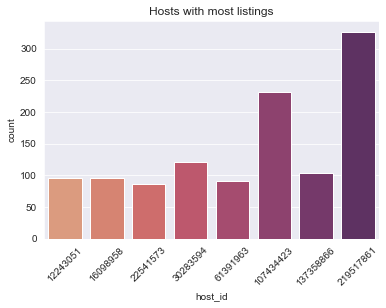

In [24]:
hosts_by_listings = data[['host_id', 'id']].groupby('host_id').count()
hosts_by_listings.reset_index(inplace=True)
hosts_by_listings.columns = ['host_id', 'count']
hosts_by_listings = hosts_by_listings.sort_values(
    'count', ascending=False)

sns.barplot(x='host_id', y='count',
            data=hosts_by_listings.head(8), palette="flare")
plt.xticks(rotation = 45)
plt.title('Hosts with most listings')
plt.show()


### Which hosts are the busiest and why?

To determine which hosts are the busiest, we will use metric that is dependant on such charachteristics as minimum nights, reviews per month and availiability. Although there is no way to determine how often the apartment/room is occupied, reviews per month is the closest characteristic, that can show us the occupancy ( assuming that tenants leave reviews at the same rate for each listing ).

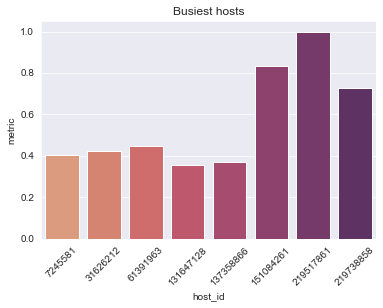

In [25]:
host_data = data[['host_id', 'minimum_nights', 'number_of_reviews',
                   'reviews_per_month', 'calculated_host_listings_count', 'availability_365']]

host_data['busy_metric'] = host_data['minimum_nights'] * host_data['reviews_per_month'] * \
    host_data['availability_365']

host_busy_data = host_data[['host_id','busy_metric']].groupby('host_id').sum()
host_busy_data.reset_index(inplace=True)
host_busy_data.columns = ['host_id', 'metric']
host_busy_data = host_busy_data.sort_values(
    'metric', ascending=False)

#minmax scaling
host_busy_data['metric'] = (host_busy_data['metric'] - \
    host_busy_data['metric'].min())/(host_busy_data['metric'].max() - \
    host_busy_data['metric'].min())

sns.barplot(x='host_id', y='metric', data=host_busy_data.head(8), palette="flare")
plt.xticks(rotation=45)
plt.title('Busiest hosts')
plt.show()


As we can see, top 1 host in listings and our busy metric is the same, but other ones are different. Next question is to determine if our busy metric correlates with listings count.

In [26]:
host_joined = hosts_by_listings.join(
    host_busy_data.set_index('host_id'), on='host_id')

In [27]:
from scipy.stats import pearsonr, spearmanr

print('Pearson correlation between metrics: ' + str(pearsonr(host_joined['count'], host_joined['metric'])[0]))
print('Spearman correlation between metrics: ' + str(spearmanr(host_joined['count'], host_joined['metric'])[0]))


Pearson correlation between metrics: 0.5429741834589017
Spearman correlation between metrics: 0.33118913065568584


As you can see, according to our analysis, a hosts with a lot of listings don't really correlate with high "busy" metric and there are surely a lot of other factors in place.

## Predicting NYC Airbnb Rental Prices

As we already know, there are a lot of outliers in data, so , for our model to perform correctly, we must tranform the data. Also, we need to reduce dimensionality of data to force our model to learn faster and do not suffer from such things as multicolinearity of some characteristics.

As our preffered model , let's use Random Forest Regressor, which should work better on our data.

First of all, let's try to normalize our target variable. For this we will use log(x+1) tranformation, beacuse we have 0 in our prices.

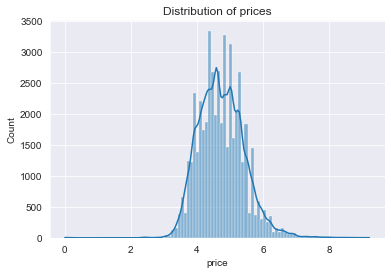

In [28]:
y = np.log(data['price']+1)

sns.histplot(x=y, bins=100, kde=True)
plt.title('Distribution of prices')
plt.show()


As we see, although not ideally, but our target variable distribution resembles normal

### Choosing characteristics

In [29]:
#reviews per months is moderately correlated with number of reviews, so we'll remove it
#name, id and host_id is irrelevant to model
#calculated_host_listings_count is characteristic of a particular host, not listing, so we can get rid of it
#change last_review to days_since_last_review, changing NaN values to -1
#neighbourhood_group already included in  neighbourhood, so we will get rid of it

X = data[['neighbourhood', 'latitude', 'longitude',
          'room_type', 'minimum_nights', 'number_of_reviews', 'availability_365']]

X['days_since_last_review'] = (
    data['last_review'].max() - data[data['last_review'].notna()]['last_review']).dt.days

#change NaN in days_since_last_review to -1

X['days_since_last_review'] = X['days_since_last_review'].fillna(-1).astype(int)


### Encoding 

Let's encode neighbourhoods and room types to get numerical data

In [30]:
from sklearn.preprocessing import LabelEncoder

X['neighbourhood'] = LabelEncoder().fit_transform(data['neighbourhood'])
X['room_type'] = LabelEncoder().fit_transform(data['room_type'])

In [31]:
X.head()

,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,availability_365,days_since_last_review
0,108,40.64749,-73.97237,1,1,9,365,262
1,127,40.75362,-73.98377,0,1,45,355,48
2,94,40.80902,-73.94190,1,3,0,365,-1
3,41,40.68514,-73.95976,0,1,270,194,3
4,61,40.79851,-73.94399,0,10,9,0,231


Let's look again if our charachteristics are correlated

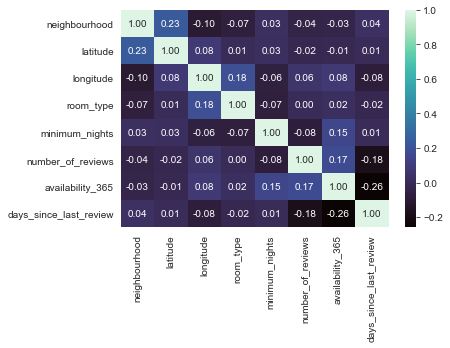

In [34]:
sns.heatmap(X.corr(), annot=True, fmt='.2f', cmap="mako")
plt.show()


As we see there is no highly corelated variables, which should be good for our model

In [32]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [39]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def get_error(y_pred, y_true):
    print(f"MSE: {mean_squared_error(y_true, y_pred)}")
    print(f"RMSE: {mean_squared_error(y_true, y_pred, squared=False)}")
    print(f"MAE: {mean_absolute_error(y_true, y_pred)}")
    print(f"R^2: {r2_score(y_true, y_pred)}")


To tune our hyperparameters, we'll use cross-validation.

In [41]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

param_grid = {'n_estimators': [200, 400],
 'min_samples_split': [5, 10],
 'min_samples_leaf': [1, 2],
 'max_features': ['sqrt'],
 'max_depth': [50, 80, 110],
 'bootstrap': [True]}

rf = RandomForestRegressor()
grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid, n_jobs=-1, verbose=2)
grid_search_rf.fit(X_train, y_train)


Fitting 5 folds for each of 24 candidates, totalling 120 fits


GridSearchCV(estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'bootstrap': [True], 'max_depth': [50, 80, 110],
                         'max_features': ['sqrt'], 'min_samples_leaf': [1, 2],
                         'min_samples_split': [5, 10],
                         'n_estimators': [200, 400]},
             verbose=2)

In [42]:
best_rf = grid_search_rf.best_estimator_
grid_search_rf.best_params_

{'bootstrap': True,
 'max_depth': 50,
 'max_features': 'sqrt',
 'min_samples_leaf': 2,
 'min_samples_split': 5,
 'n_estimators': 400}

As we see, parameters above is ones that give the best result. Let's check the accuracy of our model.

In [44]:
y_pred = best_rf.predict(X_test)
get_error(y_pred, y_test)

MSE: 0.19185409615097393
RMSE: 0.43801152513486896
MAE: 0.30966189141368566
R^2: 0.6012680289712605


As we can see, our model has pretty good accuracy, so we can say that our task is completed.